<a href="https://colab.research.google.com/github/AshvinBari/Transformer_Architecture/blob/main/Transformer_(1).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install transformers torch


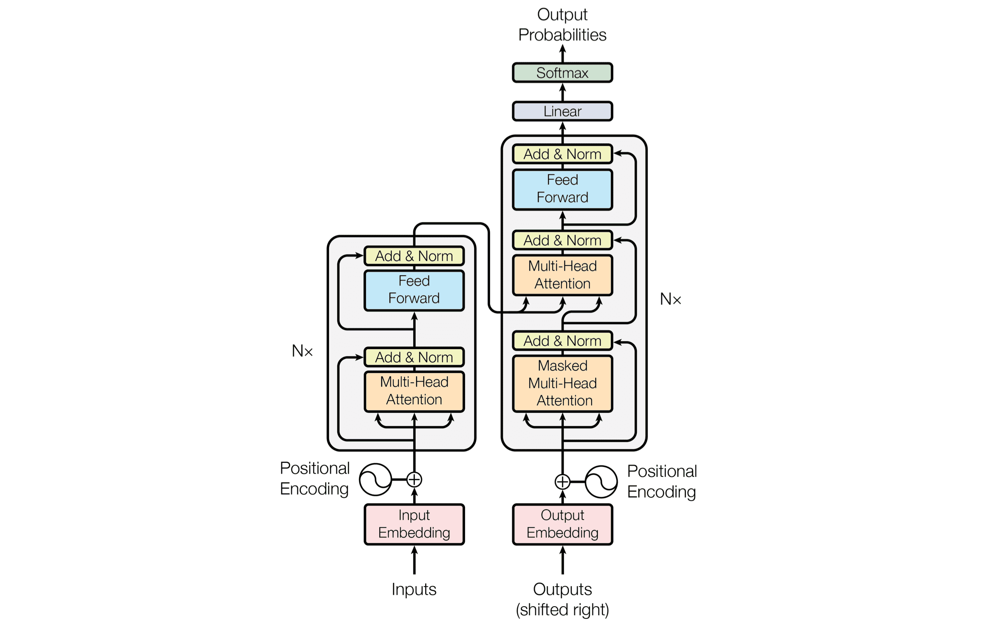

In [ ]:
from transformers import AutoTokenizer, AutoModel
import torch

# Step 1: Input text
text = " I am Ashvin  studying in US"




In [ ]:
# Step 2: Load tokenizer and model (we'll use BERT as an example)
tokenizer = AutoTokenizer.from_pretrained("bert-base-uncased")
model = AutoModel.from_pretrained("bert-base-uncased")


/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

In [ ]:

# Step 3: Tokenization
tokens = tokenizer.tokenize(text)
print("🔹 Tokens:", tokens)


🔹 Tokens: ['i', 'am', 'ash', '##vin', 'studying', 'in', 'us']


In [ ]:

token_ids = tokenizer.convert_tokens_to_ids(tokens)
print("🔹 Token IDs:", token_ids)


🔹 Token IDs: [1045, 2572, 6683, 6371, 5702, 1999, 2149]


In [ ]:

# Step 5: Convert token IDs to input tensor
inputs = tokenizer(text, return_tensors="pt")  # automatically adds special tokens like [CLS] and [SEP]
print(inputs)

{'input_ids': tensor([[ 101, 1045, 2572, 6683, 6371, 5702, 1999, 2149,  102]]), 'token_type_ids': tensor([[0, 0, 0, 0, 0, 0, 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1, 1, 1, 1, 1, 1, 1]])}


In [ ]:

# Step 6: Generate embeddings from the model
with torch.no_grad():
    outputs = model(**inputs)

# print(outputs)


/usr/local/lib/python3.11/dist-packages/torch/nn/modules/module.py:1750: FutureWarning: `encoder_attention_mask` is deprecated and will be removed in version 4.55.0 for `BertSdpaSelfAttention.forward`.
  return forward_call(*args, **kwargs)


In [ ]:

# Step 7: Extract embeddings (from the last hidden state)
#Shape: [batch_size, sequence_length, embedding_dimension]
embeddings = outputs.last_hidden_state

print("🔹 Embeddings shape:", embeddings.shape)


🔹 Embeddings shape: torch.Size([1, 9, 768])


In [ ]:

# Optional: View embeddings of each token
for token, embedding_vector in zip(tokenizer.convert_ids_to_tokens(inputs['input_ids'][0]), embeddings[0]):
    print(f"{token:10s} → Embedding vector shape: {embeddings.shape}")


[CLS]      → Embedding vector shape: torch.Size([1, 9, 768])
i          → Embedding vector shape: torch.Size([1, 9, 768])
am         → Embedding vector shape: torch.Size([1, 9, 768])
ash        → Embedding vector shape: torch.Size([1, 9, 768])
##vin      → Embedding vector shape: torch.Size([1, 9, 768])
studying   → Embedding vector shape: torch.Size([1, 9, 768])
in         → Embedding vector shape: torch.Size([1, 9, 768])
us         → Embedding vector shape: torch.Size([1, 9, 768])
[SEP]      → Embedding vector shape: torch.Size([1, 9, 768])


In [ ]:
for token, embedding_vector in zip(tokenizer.convert_ids_to_tokens(inputs['input_ids'][0]), embeddings[0]):
    print(f"{token:10s} → Embedding vector shape: {embedding_vector.shape}")

[CLS]      → Embedding vector shape: torch.Size([768])
i          → Embedding vector shape: torch.Size([768])
am         → Embedding vector shape: torch.Size([768])
ash        → Embedding vector shape: torch.Size([768])
##vin      → Embedding vector shape: torch.Size([768])
studying   → Embedding vector shape: torch.Size([768])
in         → Embedding vector shape: torch.Size([768])
us         → Embedding vector shape: torch.Size([768])
[SEP]      → Embedding vector shape: torch.Size([768])


In [ ]:

# Input text
text = "ChatGPT is smart."

# Tokenize and convert to tensor
inputs = tokenizer(text, return_tensors="pt")

# Forward pass to get embeddings
with torch.no_grad():
    outputs = model(**inputs)

# Extract embeddings (last hidden state)
# Shape: [1, sequence_length, embedding_dim]
embeddings = outputs.last_hidden_state

# Optional: Convert to one sentence vector by averaging token embeddings (excluding [CLS] and [SEP])
sentence_embedding = embeddings[0][1:-1].mean(dim=0)

print("🔹 Sentence embedding shape:", sentence_embedding.shape)
print("🔹 Sentence embedding (first 5 values):", sentence_embedding[:20])


🔹 Sentence embedding shape: torch.Size([768])
🔹 Sentence embedding (first 5 values): tensor([-3.5420e-02, -7.3610e-01,  4.7085e-01,  2.1736e-02,  3.8991e-01,
        -4.8422e-01, -5.7248e-02,  9.9099e-01, -2.0726e-01, -5.0394e-01,
        -5.4018e-02, -2.6955e-01, -3.6944e-01,  2.0692e-01, -1.2190e-01,
         4.6534e-04,  1.2472e-01,  2.4816e-01, -2.7236e-01, -3.5470e-02])


🧠 What is Positional Encoding?

Transformers have no recurrence or convolution, so they need a way to capture  

token order. Positional Encoding adds a unique vector to each token’s embedding based on its position in the sequence

$$
PE_{(pos, 2i)} = \sin\left(\frac{pos}{10000^{\frac{2i}{d_{\text{model}}}}}\right) \\
PE_{(pos, 2i+1)} = \cos\left(\frac{pos}{10000^{\frac{2i}{d_{\text{model}}}}}\right)
$$


Shape: torch.Size([50, 512])


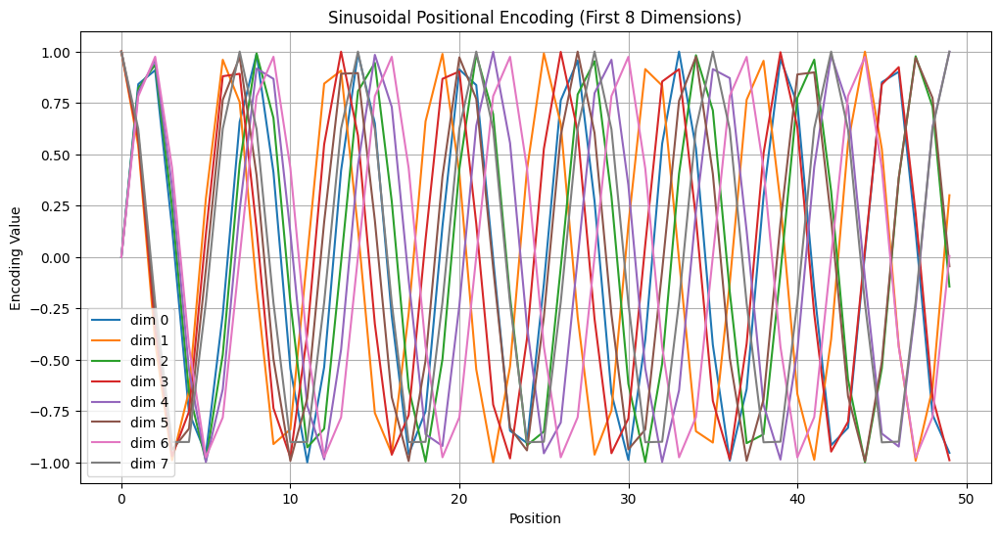

In [ ]:
import torch
import math
import matplotlib.pyplot as plt

def get_positional_encoding(seq_len, d_model):
    # Create a matrix of shape [seq_len, d_model]
    pos_encoding = torch.zeros(seq_len, d_model)

    # Create a tensor with positions [0, 1, ..., seq_len - 1]
    positions = torch.arange(0, seq_len, dtype=torch.float).unsqueeze(1)

    # Compute the div term (used in the denominator of the angle calculation)
    div_term = torch.exp(torch.arange(0, d_model, 2).float() * (-math.log(10000.0) / d_model))

    # Apply sin to even indices and cos to odd indices
    pos_encoding[:, 0::2] = torch.sin(positions * div_term)
    pos_encoding[:, 1::2] = torch.cos(positions * div_term)

    return pos_encoding

# Example usage
seq_len = 50        # max sequence length
d_model = 512       # embedding dimension
pos_encoding = get_positional_encoding(seq_len, d_model)

print("Shape:", pos_encoding.shape)  # [50, 512]

# Plot for visualization
plt.figure(figsize=(12, 6))
plt.plot(pos_encoding[:, :8])  # Plot first 8 dimensions
plt.title("Sinusoidal Positional Encoding (First 8 Dimensions)")
plt.xlabel("Position")
plt.ylabel("Encoding Value")
plt.legend([f"dim {i}" for i in range(8)])
plt.grid(True)
plt.show()


Shape: (7, 8)


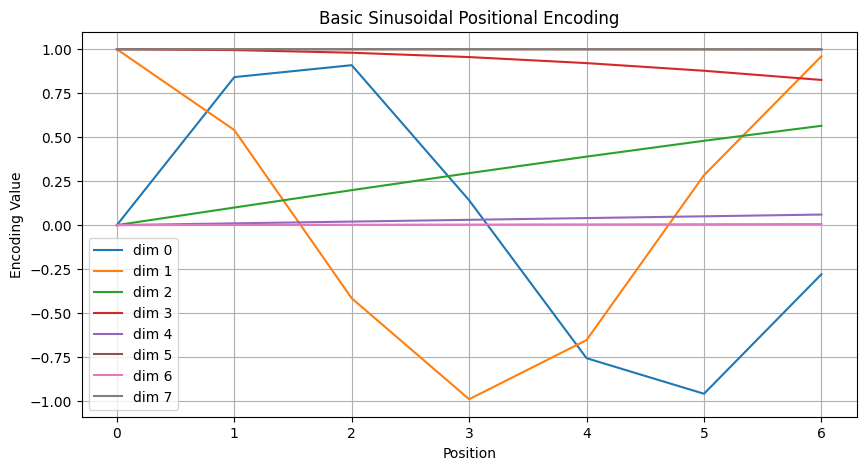

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def basic_positional_encoding(seq_len, d_model):
    pos_encoding = np.zeros((seq_len, d_model))

    for pos in range(seq_len):
        for i in range(0, d_model, 2):
            angle = pos / (10000 ** (i / d_model))
            pos_encoding[pos, i] = np.sin(angle)  # Even index
            if i + 1 < d_model:
                pos_encoding[pos, i + 1] = np.cos(angle)  # Odd index

    return pos_encoding

# Parameters
seq_len = 7     # number of positions (e.g., 20 words)
d_model = 8       # embedding dimensions

# Generate positional encodings
encoding = basic_positional_encoding(seq_len, d_model)

# Print shape
print("Shape:", encoding.shape)  # (20, 8)

# Plot
plt.figure(figsize=(10, 5))
for i in range(d_model):
    plt.plot(encoding[:, i], label=f"dim {i}")
plt.xlabel("Position")
plt.ylabel("Encoding Value")
plt.title("Basic Sinusoidal Positional Encoding")
plt.legend()
plt.grid(True)
plt.show()


Tokens: ['I', 'am', 'ashvinkumar', 'bari', 'i', 'can', 'wrok', 'on', 'AI', 'project']

Positional Encoding Shape: (10, 10)

Positional Encodings: [[ 0.00000000e+00  1.00000000e+00  0.00000000e+00  1.00000000e+00
   0.00000000e+00  1.00000000e+00  0.00000000e+00  1.00000000e+00
   0.00000000e+00  1.00000000e+00]
 [ 8.41470985e-01  5.40302306e-01  1.57826640e-01  9.87466836e-01
   2.51162229e-02  9.99684538e-01  3.98106119e-03  9.99992076e-01
   6.30957303e-04  9.99999801e-01]
 [ 9.09297427e-01 -4.16146837e-01  3.11697146e-01  9.50181503e-01
   5.02165994e-02  9.98738351e-01  7.96205928e-03  9.99968302e-01
   1.26191435e-03  9.99999204e-01]
 [ 1.41120008e-01 -9.89992497e-01  4.57754548e-01  8.89078609e-01
   7.52852930e-02  9.97162035e-01  1.19429312e-02  9.99928681e-01
   1.89287090e-03  9.99998209e-01]
 [-7.56802495e-01 -6.53643621e-01  5.92337725e-01  8.05689779e-01
   1.00306487e-01  9.94956586e-01  1.59236138e-02  9.99873211e-01
   2.52382670e-03  9.99996815e-01]
 [-9.58924275e-01  

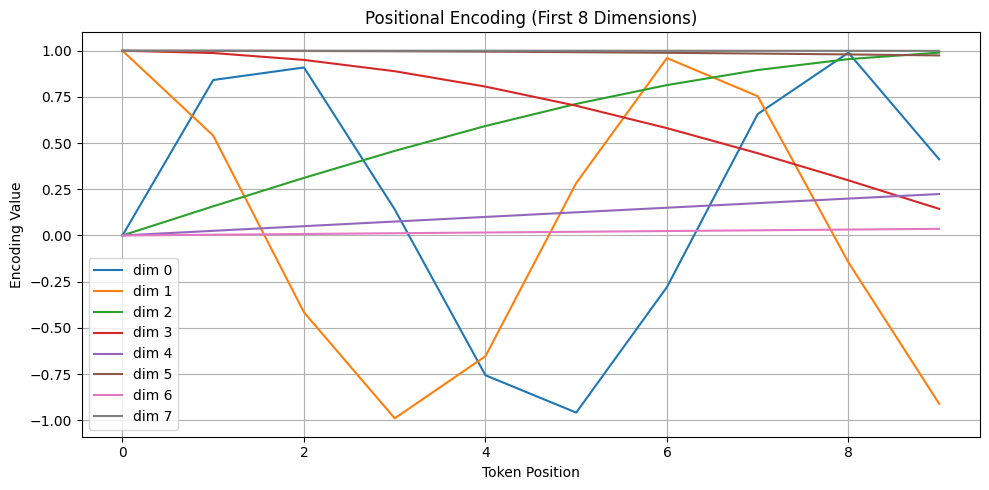

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def positional_encoding(seq_len, d_model):
    pos_enc = np.zeros((seq_len, d_model))
    for pos in range(seq_len):
        for i in range(0, d_model, 2):
            angle = pos / (10000 ** (i / d_model))
            pos_enc[pos, i] = np.sin(angle)
            if i + 1 < d_model:
                pos_enc[pos, i + 1] = np.cos(angle)
    return pos_enc

# Step 1: Input text
text = "I am ashvinkumar bari  i can wrok on AI project "
tokens = text.split()
seq_len = len(tokens)
d_model = 10
  # Embedding dimension (choose 16 for easy visualization)

# Step 2: Dummy word embeddings (zeros or random)
word_embeddings = np.random.rand(seq_len, d_model)  # You can use np.zeros(...) for simplicity

# Step 3: Generate positional encodings
pos_enc = positional_encoding(seq_len, d_model)

# Step 4: Combine embeddings + positional encodings
final_embeddings = word_embeddings + pos_enc

# Step 5: Print info
print("Tokens:", tokens)
print("\nPositional Encoding Shape:", pos_enc.shape)
print("\nPositional Encodings:", pos_enc)
print("\nFinal Embeddings (with Positional Encoding):")
for i, token in enumerate(tokens):
    print(f"{token:12s} → {final_embeddings[i]}")

# Step 6: Plot positional encodings (first 8 dimensions)
plt.figure(figsize=(10, 5))
for i in range(8):
    plt.plot(pos_enc[:, i], label=f"dim {i}")
plt.title("Positional Encoding (First 8 Dimensions)")
plt.xlabel("Token Position")
plt.ylabel("Encoding Value")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()



**MultiHeadAttention**

In [ ]:
import torch
import torch.nn.functional as F

class MultiHeadAttention(torch.nn.Module):
    def __init__(self, embed_dim, num_heads):
        super().__init__()
        assert embed_dim % num_heads == 0

        self.embed_dim = embed_dim
        self.num_heads = num_heads
        self.head_dim = embed_dim // num_heads

        # Define linear layers for Q, K, V
        self.q_linear = torch.nn.Linear(embed_dim, embed_dim)
        self.k_linear = torch.nn.Linear(embed_dim, embed_dim)
        self.v_linear = torch.nn.Linear(embed_dim, embed_dim)

        # Final output linear layer
        self.out_linear = torch.nn.Linear(embed_dim, embed_dim)

    def forward(self, x):
        batch_size, seq_len, embed_dim = x.size()

        # Linear projections
        Q = self.q_linear(x)  # (B, S, E)
        K = self.k_linear(x)
        V = self.v_linear(x)

        # Split heads
        Q = Q.view(batch_size, seq_len, self.num_heads, self.head_dim).transpose(1, 2)
        K = K.view(batch_size, seq_len, self.num_heads, self.head_dim).transpose(1, 2)
        V = V.view(batch_size, seq_len, self.num_heads, self.head_dim).transpose(1, 2)

        # Scaled Dot-Product Attention
        scores = torch.matmul(Q, K.transpose(-2, -1)) / (self.head_dim ** 0.5)
        attn = F.softmax(scores, dim=-1)

        out = torch.matmul(attn, V)  # (B, H, S, D_head)

        # Concatenate heads
        out = out.transpose(1, 2).contiguous().view(batch_size, seq_len, self.embed_dim)

        # Final linear layer
        return self.out_linear(out)

# Test
embed_dim = 8
num_heads = 2
seq_len = 4
batch_size = 1

x = torch.rand(batch_size, seq_len, embed_dim)
mha = MultiHeadAttention(embed_dim, num_heads)

output = mha(x)
print("Output shape:", output.shape)  # Should be (1, 4, 8)
print(mha)


Output shape: torch.Size([1, 4, 8])
MultiHeadAttention(
  (q_linear): Linear(in_features=8, out_features=8, bias=True)
  (k_linear): Linear(in_features=8, out_features=8, bias=True)
  (v_linear): Linear(in_features=8, out_features=8, bias=True)
  (out_linear): Linear(in_features=8, out_features=8, bias=True)
)


In [ ]:
import torch
import torch.nn.functional as F

# Define a basic Multi-Head Attention class
class MultiHeadAttention(torch.nn.Module):
    def __init__(self, embed_dim, num_heads):
        super().__init__()
        assert embed_dim % num_heads == 0, "Embedding dimension must be divisible by number of heads."

        self.embed_dim = embed_dim
        self.num_heads = num_heads
        self.head_dim = embed_dim // num_heads

        self.q_linear = torch.nn.Linear(embed_dim, embed_dim)
        self.k_linear = torch.nn.Linear(embed_dim, embed_dim)
        self.v_linear = torch.nn.Linear(embed_dim, embed_dim)

        self.out_linear = torch.nn.Linear(embed_dim, embed_dim)

    def forward(self, x):
        batch_size, seq_len, embed_dim = x.size()

        # Step 1: Linear projections
        Q = self.q_linear(x)  # (batch_size, seq_len, embed_dim)
        K = self.k_linear(x)
        V = self.v_linear(x)

        # Step 2: Split into heads
        Q = Q.view(batch_size, seq_len, self.num_heads, self.head_dim).transpose(1, 2)
        K = K.view(batch_size, seq_len, self.num_heads, self.head_dim).transpose(1, 2)
        V = V.view(batch_size, seq_len, self.num_heads, self.head_dim).transpose(1, 2)

        # Step 3: Scaled dot-product attention
        scores = torch.matmul(Q, K.transpose(-2, -1)) / (self.head_dim ** 0.5)
        attn_weights = F.softmax(scores, dim=-1)
        attn_output = torch.matmul(attn_weights, V)

        # Step 4: Concatenate heads
        attn_output = attn_output.transpose(1, 2).contiguous().view(batch_size, seq_len, embed_dim)

        # Step 5: Final linear layer
        output = self.out_linear(attn_output)

        return output, attn_weights


# Sample Input
torch.manual_seed(42)  # For reproducibility

batch_size = 1
seq_len = 3
embed_dim = 6
num_heads = 2

# Dummy input: 3 tokens, each with 6-dimensional embedding
x = torch.tensor([
    [[1.0, 0.0, 1.0, 0.0, 1.0, 0.0],
     [0.0, 1.0, 0.0, 1.0, 0.0, 1.0],
     [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]]
], dtype=torch.float32)

# Initialize MHA
mha = MultiHeadAttention(embed_dim=embed_dim, num_heads=num_heads)

# Forward pass
output, attn_weights = mha(x)

# Print Results
print("Input shape:", x.shape)
print("Attention output:\n", output)
print("Attention weights:\n", attn_weights)


Input shape: torch.Size([1, 3, 6])
Attention output:
 tensor([[[-0.2469,  0.4004,  0.6238, -0.3918,  0.2692,  0.2229],
         [-0.2454,  0.3988,  0.6259, -0.3890,  0.2745,  0.2253],
         [-0.2590,  0.4088,  0.6217, -0.4033,  0.2642,  0.2175]]],
       grad_fn=<ViewBackward0>)
Attention weights:
 tensor([[[[0.3604, 0.3035, 0.3361],
          [0.3358, 0.2907, 0.3736],
          [0.3653, 0.2529, 0.3818]],

         [[0.2769, 0.4079, 0.3152],
          [0.2904, 0.3795, 0.3300],
          [0.2426, 0.4579, 0.2995]]]], grad_fn=<SoftmaxBackward0>)


In [ ]:
import torch
import torch.nn.functional as F

class MultiHeadAttention(torch.nn.Module):
    def __init__(self, embed_dim, num_heads):
        super().__init__()
        assert embed_dim % num_heads == 0, "Embedding dimension must be divisible by number of heads."

        self.embed_dim = embed_dim
        self.num_heads = num_heads
        self.head_dim = embed_dim // num_heads

        self.q_linear = torch.nn.Linear(embed_dim, embed_dim)
        self.k_linear = torch.nn.Linear(embed_dim, embed_dim)
        self.v_linear = torch.nn.Linear(embed_dim, embed_dim)
        self.out_linear = torch.nn.Linear(embed_dim, embed_dim)

    def forward(self, x):
        batch_size, seq_len, embed_dim = x.size()

        # Step 1: Linear projections
        Q = self.q_linear(x)  # (B, S, E)
        K = self.k_linear(x)
        V = self.v_linear(x)

        print("\n=== Raw Q ===\n", Q)
        print("\n=== Raw K ===\n", K)
        print("\n=== Raw V ===\n", V)

        # Step 2: Split into heads
        Q = Q.view(batch_size, seq_len, self.num_heads, self.head_dim).transpose(1, 2)
        K = K.view(batch_size, seq_len, self.num_heads, self.head_dim).transpose(1, 2)
        V = V.view(batch_size, seq_len, self.num_heads, self.head_dim).transpose(1, 2)

        print("\n=== Q Heads ===\n", Q)
        print("\n=== K Heads ===\n", K)
        print("\n=== V Heads ===\n", V)

        # Step 3: Attention weights
        scores = torch.matmul(Q, K.transpose(-2, -1)) / (self.head_dim ** 0.5)
        attn_weights = F.softmax(scores, dim=-1)

        # Step 4: Attention output
        attn_output = torch.matmul(attn_weights, V)
        attn_output = attn_output.transpose(1, 2).contiguous().view(batch_size, seq_len, embed_dim)

        output = self.out_linear(attn_output)

        return output, attn_weights


# ====== Sample Input ======
torch.manual_seed(42)

batch_size = 1
seq_len = 3
embed_dim = 6
num_heads = 2

x = torch.tensor([
    [[1.0, 0.0, 1.0, 0.0, 1.0, 0.0],   # Token 1
     [0.0, 1.0, 0.0, 1.0, 0.0, 1.0],   # Token 2
     [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]]   # Token 3
], dtype=torch.float32)

# ====== Run MHA ======
mha = MultiHeadAttention(embed_dim=embed_dim, num_heads=num_heads)
output, attn_weights = mha(x)

print("\n=== Final Attention Output ===\n", output)
print("\n=== Attention Weights ===\n", attn_weights)


=== Raw Q ===
 tensor([[[ 0.1907,  0.8458,  0.8578, -0.6732, -0.2893,  0.4406],
         [ 0.8599,  0.3465,  0.1026,  0.1983, -0.7272, -0.1373],
         [ 0.9869,  0.8625,  0.9158, -0.3462, -1.1262,  0.4140]]],
       grad_fn=<ViewBackward0>)

=== Raw K ===
 tensor([[[ 0.7897, -0.1707,  0.3554, -0.0016,  0.6789, -0.4517],
         [ 0.4052,  0.2676, -0.3389, -0.7826, -0.1328, -0.6560],
         [ 1.0487, -0.2423,  0.2273, -0.5059,  0.3295, -0.9427]]],
       grad_fn=<ViewBackward0>)

=== Raw V ===
 tensor([[[ 0.2764, -0.1183, -0.0330, -0.6673, -0.1036, -0.6184],
         [-0.2885, -0.1964, -0.4591, -1.0767, -0.8438, -0.9777],
         [-0.0132, -0.1628, -0.4638, -1.4673, -0.6672, -1.3579]]],
       grad_fn=<ViewBackward0>)

=== Q Heads ===
 tensor([[[[ 0.1907,  0.8458,  0.8578],
          [ 0.8599,  0.3465,  0.1026],
          [ 0.9869,  0.8625,  0.9158]],

         [[-0.6732, -0.2893,  0.4406],
          [ 0.1983, -0.7272, -0.1373],
          [-0.3462, -1.1262,  0.4140]]]], grad_fn=

In [ ]:
!pip install bertviz

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 157.5/157.5 kB 9.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.9/139.9 kB 16.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.9/13.9 MB 208.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 106.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.3/85.3 kB 9.2 MB/s eta 0:00:00


In [ ]:
# Load model and retrieve attention weights

from bertviz import head_view, model_view
from transformers import BertTokenizer, BertModel

model_version = 'bert-base-uncased'
model = BertModel.from_pretrained(model_version, output_attentions=True)
tokenizer = BertTokenizer.from_pretrained(model_version)
sentence_a = "Ashvin bari  went to the recreation"
sentence_b = "Ashvin Patil went to play pickelball"
inputs = tokenizer.encode_plus(sentence_a, sentence_b, return_tensors='pt')
input_ids = inputs['input_ids']
token_type_ids = inputs['token_type_ids']
attention = model(input_ids, token_type_ids=token_type_ids)[-1]
sentence_b_start = token_type_ids[0].tolist().index(1)
input_id_list = input_ids[0].tolist() # Batch index 0
tokens = tokenizer.convert_ids_to_tokens(input_id_list)

**Head View**

In [ ]:
head_view(attention, tokens, sentence_b_start)

<IPython.core.display.Javascript object>

**Model View**

In [ ]:
model_view(attention, tokens, sentence_b_start)

<IPython.core.display.Javascript object>

Neuron View

In [ ]:
from bertviz.transformers_neuron_view import BertModel, BertTokenizer
from bertviz.neuron_view import show

model_type = 'bert'
model_version = 'bert-base-uncased'
model = BertModel.from_pretrained(model_version, output_attentions=True)
tokenizer = BertTokenizer.from_pretrained(model_version, do_lower_case=True)
show(model, model_type, tokenizer, sentence_a, sentence_b, layer=4, head=3)

100%|██████████| 231508/231508 [00:00<00:00, 903658.07B/s]


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Feed Forward

In [ ]:
import torch

class FeedForwardScratch:
    def __init__(self, d_model, d_ff):
        self.d_model = d_model
        self.d_ff = d_ff

        # Initialize weights and biases manually
        self.W1 = torch.randn(d_model, d_ff) * (1.0 / (d_model ** 0.5))
        self.b1 = torch.zeros(d_ff)

        self.W2 = torch.randn(d_ff, d_model) * (1.0 / (d_ff ** 0.5))
        self.b2 = torch.zeros(d_model)

    def relu(self, x):
        return torch.maximum(x, torch.zeros_like(x))

    def forward(self, x):
        # x shape: (batch_size, seq_len, d_model)

        # Linear1: (batch, seq_len, d_model) @ (d_model, d_ff) → (batch, seq_len, d_ff)
        x1 = torch.matmul(x, self.W1) + self.b1  # Add bias manually (broadcasting)
        x1 = self.relu(x1)

        # Linear2: (batch, seq_len, d_ff) @ (d_ff, d_model) → (batch, seq_len, d_model)
        out = torch.matmul(x1, self.W2) + self.b2

        return out


In [ ]:
# Parameters
batch_size = 2
seq_len = 4
d_model = 8
d_ff = 16

# Dummy input
x = torch.randn(batch_size, seq_len, d_model)

# Feed Forward Network from scratch
ffn = FeedForwardScratch(d_model=d_model, d_ff=d_ff)
output = ffn.forward(x)

print("Input shape:", x.shape)
print("Output shape:", output.shape)


Input shape: torch.Size([2, 4, 8])
Output shape: torch.Size([2, 4, 8])


Add Normalization

output = LayerNorm(x + SubLayer(x))

In [ ]:
import torch
import torch.nn as nn

class AddNorm(nn.Module):
    def __init__(self, hidden_dim, eps=1e-6):
        super(AddNorm, self).__init__()
        self.layer_norm = nn.LayerNorm(hidden_dim, eps=eps)

    def forward(self, x, sublayer_output):
        # Residual connection + Layer Normalization
        return self.layer_norm(x + sublayer_output)



In [ ]:
# Define dimensions
batch_size = 2
seq_len = 4
hidden_dim = 8

# Dummy input tensor (x)
x = torch.rand(batch_size, seq_len, hidden_dim)

# Simulate output from some sublayer (like self-attention or FFN)
sublayer_output = torch.rand(batch_size, seq_len, hidden_dim)

# Create the Add & Norm layer
add_norm = AddNorm(hidden_dim)

# Forward pass
output = add_norm(x, sublayer_output)

print("Output shape:", output.shape)
print("Output:", output)


Output shape: torch.Size([2, 4, 8])
Output: tensor([[[ 0.3491, -1.7750,  1.2026,  1.3946,  0.0932, -0.3001, -1.1038,
           0.1394],
         [-0.3286, -1.4481, -1.5871,  0.5292,  1.1130,  0.6294, -0.0724,
           1.1645],
         [ 1.8694, -0.9897, -0.7544,  1.3528,  0.0522, -0.7319, -0.7663,
          -0.0322],
         [ 0.0650,  0.8484, -0.8401, -1.5032,  1.2306, -1.2833,  0.9000,
           0.5826]],

        [[ 1.3775,  0.0671,  0.8735, -1.1200, -0.6128, -1.7317,  0.7296,
           0.4169],
         [-1.0725, -1.5707,  0.0217, -0.0860,  1.0979,  1.1276, -0.7028,
           1.1849],
         [-0.9275,  0.6385, -0.5202,  0.4761, -1.4324, -0.8579,  1.2570,
           1.3664],
         [-0.4716, -0.9330,  1.9577, -0.9921, -0.5859,  0.3410, -0.4937,
           1.1777]]], grad_fn=<NativeLayerNormBackward0>)


In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class MaskedMultiHeadAttention(nn.Module):
    def __init__(self, embed_dim, num_heads):
        super(MaskedMultiHeadAttention, self).__init__()
        assert embed_dim % num_heads == 0, "Embedding dim must be divisible by num_heads"

        self.embed_dim = embed_dim
        self.num_heads = num_heads
        self.head_dim = embed_dim // num_heads

        # Linear projections for Q, K, V
        self.q_proj = nn.Linear(embed_dim, embed_dim)
        self.k_proj = nn.Linear(embed_dim, embed_dim)
        self.v_proj = nn.Linear(embed_dim, embed_dim)
        self.out_proj = nn.Linear(embed_dim, embed_dim)

    def forward(self, x):
        B, T, E = x.shape  # Batch, Time, Embedding
        H = self.num_heads
        D = self.head_dim

        # Linear projections
        q = self.q_proj(x).view(B, T, H, D).transpose(1, 2)  # (B, H, T, D)
        k = self.k_proj(x).view(B, T, H, D).transpose(1, 2)  # (B, H, T, D)
        v = self.v_proj(x).view(B, T, H, D).transpose(1, 2)  # (B, H, T, D)

        # Scaled dot-product attention
        scores = torch.matmul(q, k.transpose(-2, -1)) / (D ** 0.5)  # (B, H, T, T)

        # Mask: prevent attending to future tokens
        mask = torch.tril(torch.ones(T, T, device=x.device)).unsqueeze(0).unsqueeze(0)  # (1, 1, T, T)
        scores = scores.masked_fill(mask == 0, float('-inf'))  # Causal mask

        attn = F.softmax(scores, dim=-1)  # (B, H, T, T)
        out = torch.matmul(attn, v)  # (B, H, T, D)

        # Concatenate heads
        out = out.transpose(1, 2).contiguous().view(B, T, E)  # (B, T, E)
        return self.out_proj(out)

# Example usage
batch_size = 2
seq_len = 5
embed_dim = 32
num_heads = 4

x = torch.rand(batch_size, seq_len, embed_dim)  # dummy input
masked_attn = MaskedMultiHeadAttention(embed_dim, num_heads)
out = masked_attn(x)

print(out.shape)  # Expected: (2, 5, 32)


torch.Size([2, 5, 32])
